In [66]:
#KLANGPROBE

In [67]:
#Generate audio Information Output

In [1]:
import os
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import librosa
import IPython.display as ipd
%matplotlib inline
from IPython.display import Audio
import soundfile as sf

In [69]:
#LoadMusicFile

In [39]:
#name="../Output/journey/journey_"
#path = "../" +"Data/journey/Journey - Gameplay  Playthrough (No Commentary)-[AudioTrimmer.com].mp3"

name="../Output/mario/mario_"
path = "../" +"Data/mario/Super Mario 64 [Part 1꞉ Bob-omb Battlefield] (No Commentary)-[AudioTrimmer.com].mp3"

#name="../Output/silenthill/silenthill_"
#path = "../" +"Data/silenthill/Silent Hill  Full UHD 4K  Longplay Walkthrough Gameplay No Commentary - 01.mp3"

x, Fs = librosa.load(path)
    
if len(x.shape) != 1:
    x = 0.5+(x[:, 0]+x[:, 1])

Audio(x, rate=Fs)

In [40]:
length_in_seconds = x.shape[0]/Fs
print('Sample rate: Fs=%0.0f Hz' % (Fs))
print('Length: %1d:%02d minutes' % (length_in_seconds//60, np.remainder(length_in_seconds, 60)))

Sample rate: Fs=22050 Hz
Length: 2:00 minutes


In [72]:
#SPECTOGRAM

Shape of spectrogram: (2049, 1293)


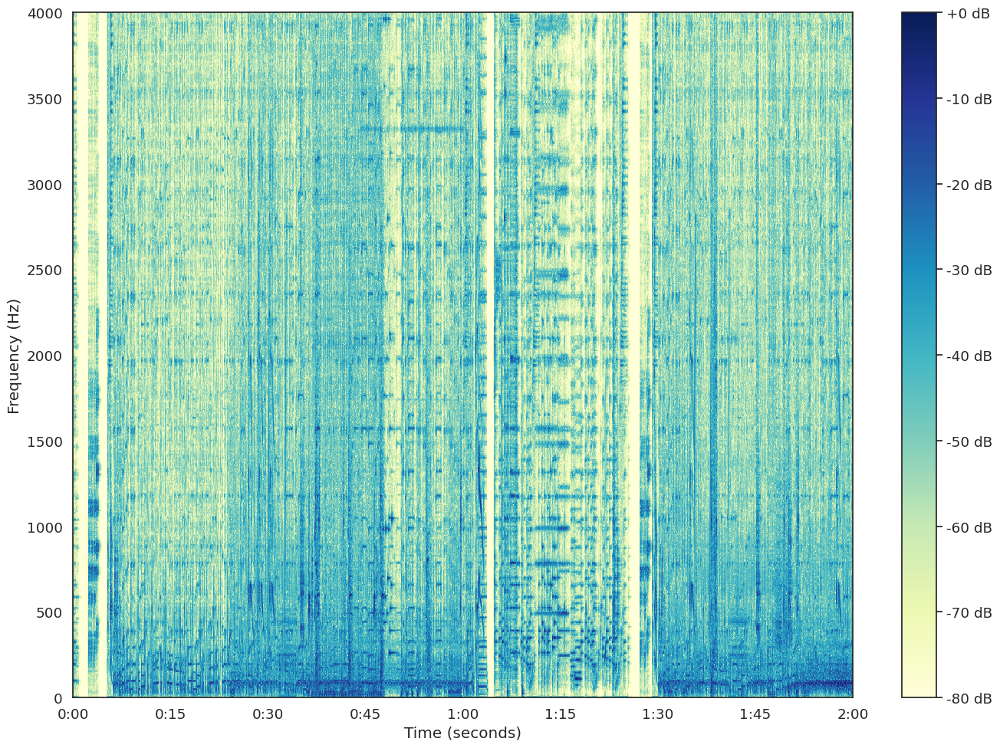

In [73]:
#choosing ColorBars: 
#https://matplotlib.org/stable/users/explain/colors/colormaps.html

from librosa import display

fac = 2
N, H = fac*2048, fac*1024

X = librosa.stft(x, n_fft=N, hop_length=H, win_length=N, window='bartlett')
Y = np.abs(X)
print('Shape of spectrogram:', Y.shape)

plt.figure(figsize=(14, 10))
display.specshow(librosa.amplitude_to_db(Y, ref=np.max), 
                         y_axis='linear', x_axis='time', sr=Fs, hop_length=H, cmap='YlGnBu')
plt.colorbar(format='%+2.0f dB')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
# plt.xlim([30, 40])
plt.ylim([0, 4000])
plt.tight_layout()

plt.savefig(name + 'spectogram.png')

In [74]:
#PITCH CLASSES

tuning offset: 0.050000000000000044


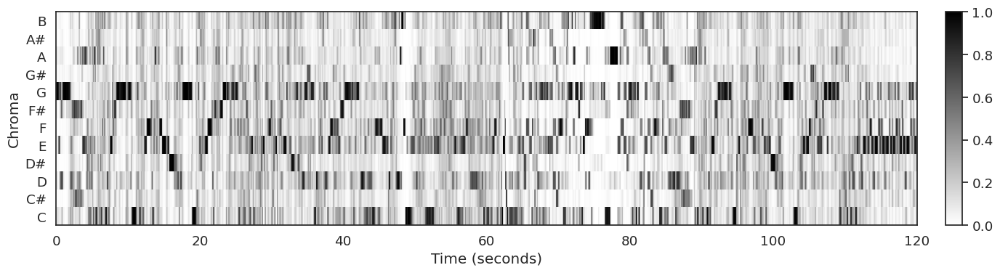

In [75]:
import sys
sys.path.append('..')

import matplotlib.gridspec as gridspec
import libfmp.b
import libfmp.c3


# estimate tuning
tuning_offset = librosa.estimate_tuning(y=x, sr=Fs, S=None, n_fft=4096, resolution=0.01, bins_per_octave=12)

print('tuning offset: '+str(tuning_offset))

# set chroma parameters
N = 4096
H = 2205
gamma = 100
norm_p = 2;

# compute chroma features with elliptic filter bank
P = librosa.iirt(y=x, sr=Fs, win_length=N, hop_length=H, center=True, tuning=tuning_offset)
C = librosa.feature.chroma_cqt(C=P, bins_per_octave=12, n_octaves=7, fmin=librosa.midi_to_hz(24), norm=norm_p)
# C = librosa.feature.chroma_cqt(y=x, bins_per_octave=12, n_octaves=7, fmin=librosa.midi_to_hz(24), norm=norm_p, tuning=tuning_offset)

# Plot chromagram
chroma_label = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

plt.figure(figsize=(14, 4))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 0.02])

ax0 = plt.subplot(gs[0, 0])
ax1 = plt.subplot(gs[0, 1])

libfmp.b.plot_matrix(C, ax=[ax0, ax1], Fs=Fs/H, clim=[0, 1], ylabel='Chroma', interpolation='none')
ax0.set_yticks(np.arange(12))
ax0.set_yticklabels(chroma_label)

plt.tight_layout()
plt.savefig(name + 'chroma.png')

In [76]:
#CHORD ESTIMATION

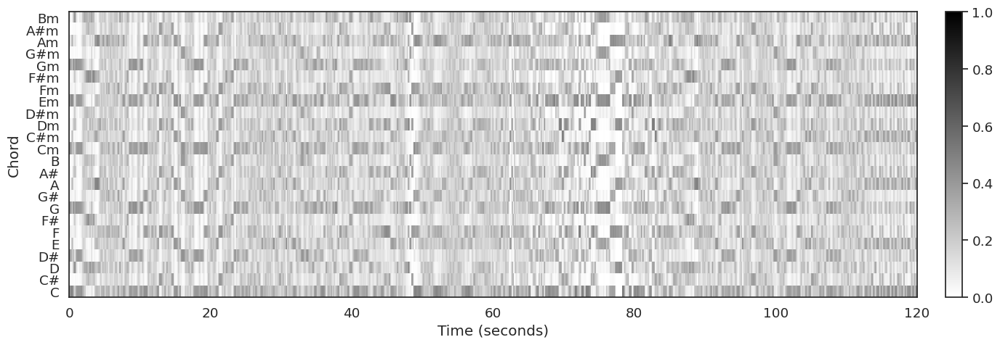

In [77]:
def generate_template_matrix(templates):
    
    assert templates.shape[0] == 12, 'input "templatesC" has wrong size!'
    
    template_matrix = np.zeros((12, 12 * templates.shape[1]))

    for shift in range(12):
        template_matrix[:, shift::12] = np.roll(templates, shift, axis=0)

    return template_matrix


def analysis_template_match(f_chroma, templates, apply_normalization=True, norm_output='2'):
    
    assert templates.shape[0] == 12, 'input "f_chroma" has wrong size!'
    assert templates.shape[0] == 12, 'input "templates" has wrong size!'
    
    chroma_normalized = libfmp.c3.normalize_feature_sequence(f_chroma, norm='2')
    templates_normalized = libfmp.c3.normalize_feature_sequence(templates, norm='2')
    
    f_analysis = np.matmul(templates_normalized.T, chroma_normalized)
    if apply_normalization:
         f_analysis = libfmp.c3.normalize_feature_sequence(f_analysis, norm=norm_output)

    return f_analysis


# Define templates
template_cmaj = np.array([[1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0]]).T
template_cmin = np.array([[1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0]]).T

templates_majmin = generate_template_matrix(np.concatenate((template_cmaj, template_cmin), axis=1))

# Define labels
chord_label_maj = chroma_label
chord_label_min = [s + 'm' for s in chroma_label]
chord_labels = chord_label_maj + chord_label_min


# Template-based chord recognition
f_analysis = analysis_template_match(C, templates_majmin, apply_normalization=True, norm_output='2')
chord_probs = f_analysis

# Plot the resulting time-chord representation f_analysis as grayscale image using imshow.

# Generate chord labels
chord_labels = chord_label_maj + chord_label_min

plt.figure(figsize=(14, 5))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 0.02])

ax0 = plt.subplot(gs[0, 0])
ax1 = plt.subplot(gs[0, 1])

libfmp.b.plot_matrix(f_analysis, ax=[ax0, ax1], Fs=Fs/H, clim=[0, 1], ylabel='Chord', interpolation='none')
ax0.set_yticks(np.arange(24))
ax0.set_yticklabels(chord_labels)

plt.tight_layout()
plt.savefig(name + 'chordEstimation.png')

In [78]:
#LABEL ASSIGNMENT

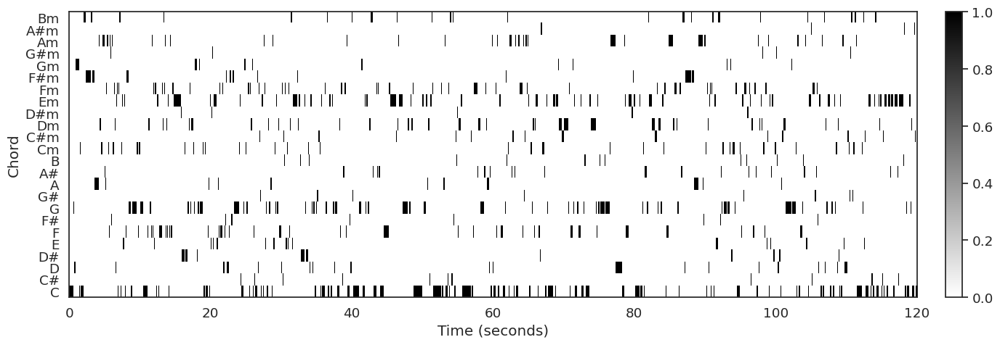

In [79]:
# Compute binary matrix of maximizing entries only
f_analysis_max = (f_analysis == f_analysis.max(axis=0)).astype(int)
chords_fine = f_analysis_max

# Plot the binary time-chord representation f_analysis_max
plt.figure(figsize=(14, 5))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 0.02])

ax0 = plt.subplot(gs[0, 0])
ax1 = plt.subplot(gs[0, 1])

libfmp.b.plot_matrix(f_analysis_max, ax=[ax0, ax1], Fs=Fs/H, clim=[0, 1], ylabel='Chord', interpolation='none')
ax0.set_yticks(np.arange(24))
ax0.set_yticklabels(chord_labels)

plt.tight_layout()
plt.savefig(name + 'labelAssignment.png')

In [80]:
#TEMPORAL SMOOTHING

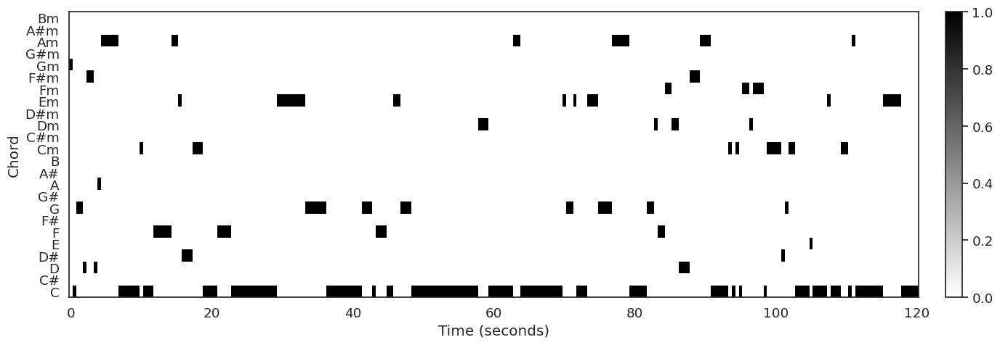

In [81]:
from scipy import signal

# average filtering

filt_len = 31
down_sampling=5
C_filtered, Fs_smooth = libfmp.c3.smooth_downsample_feature_sequence(C, Fs=Fs/H, filt_len=filt_len, down_sampling=down_sampling)
C_filtered = libfmp.c3.normalize_feature_sequence(C_filtered, norm='2')
C_filtered_chords, down_samp_chords = C_filtered, down_sampling

f_analysis_prefilt = analysis_template_match(C_filtered, templates_majmin, apply_normalization=True, norm_output='2')
f_analysis_max_prefilt = (f_analysis_prefilt==f_analysis_prefilt.max(axis=0)).astype(int)
chords_filtered, filt_len_chords = f_analysis_max_prefilt, filt_len

plt.figure(figsize=(14, 5))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 0.02])

ax0 = plt.subplot(gs[0, 0])
ax1 = plt.subplot(gs[0, 1])

H_down = H*down_sampling

libfmp.b.plot_matrix(f_analysis_max_prefilt, ax=[ax0, ax1], Fs=Fs/H_down, clim=[0, 1], ylabel='Chord', interpolation='none')
ax0.set_yticks(np.arange(24))
ax0.set_yticklabels(chord_labels)

plt.tight_layout()

plt.savefig(name + 'temporalSmoothing.png')

In [82]:
#DIATONIC SCALE 

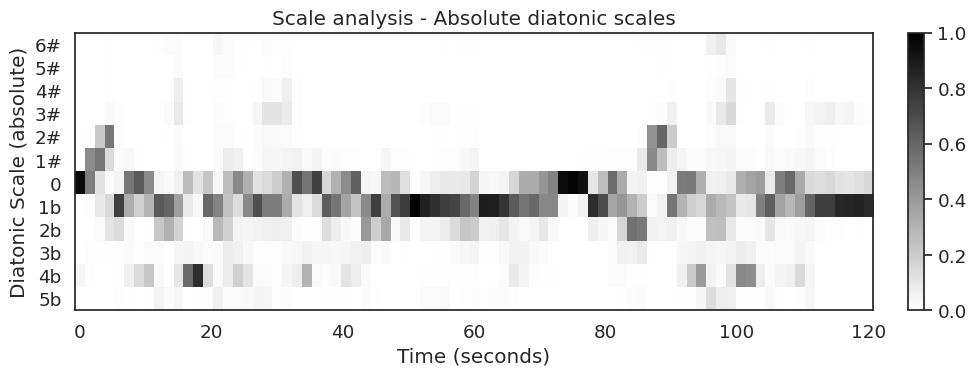

In [83]:

def sort_by_fifths(feature_sequence, offset=0):
    
    fifth_indices = np.mod(np.arange(0,12)*7,12)
    assert(feature_sequence.shape[0]==12), 'input "templatesC" has wrong size!'
    feature_sequence_sorted = np.roll(feature_sequence[fifth_indices,:], shift=-offset, axis=0)

    return feature_sequence_sorted


filt_len = 41
down_sampling = 15
C_filtered, Fs_smooth = libfmp.c3.smooth_downsample_feature_sequence(C, Fs=Fs/H, filt_len=filt_len, down_sampling=down_sampling)
# C_filtered, Fs_smooth = LibFMP.C3.median_downsample_feature_sequence(C, Fs=Fs/H, filt_len=filt_len, down_sampling=down_sampling)
C_filtered = libfmp.c3.normalize_feature_sequence(C_filtered, norm='2')
C_filtered_scales, down_samp_scales = C_filtered, down_sampling

# re-order chroma by perfect fifths
offset = -5  # start with pitch class Db
# offset = 0  # start with pitch class F
C_sorted = sort_by_fifths(C_filtered, offset=offset)
chroma_label_sorted = ['F', 'C', 'G', 'D', 'A', 'E', 'B', 'F#', 'C#', 'G#', 'D#', 'A#']

# Scale analysis
# template0Diatonic = np.array([[1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]]).T
template0Diatonic = np.array([[1, 3, 2, 1, 2, 3, 1, 0, 0, 0, 0, 0]]).T
# template0major = np.array([[1, 2, 2, 1, 1, 2, 1, 0, 0, 0, 0, 0]]).T
# template0minor = np.array([[1, 2, 1, 1, 1, 2, 2, 0, 0, 0, 0, 0]]).T
templates_scale = generate_template_matrix(template0Diatonic)

templates_scale = generate_template_matrix(template0Diatonic)
f_analysis = analysis_template_match(C_sorted, templates_scale, apply_normalization=False, norm_output='2')
f_analysis_norm = libfmp.c3.normalize_feature_sequence(f_analysis, norm='2')

# re-order analysis by perfect fifths
f_analysis_sorted = f_analysis_norm

# Soft-max rescaling (="opposite" of logarithmic compression)
f_analysis_exp = np.exp(50*f_analysis_sorted)
f_analysis_rescaled, down_samp_scales = f_analysis_exp/f_analysis_exp.sum(axis=0), down_sampling

scales, down_samp_scales = f_analysis_rescaled, down_sampling

# scale_labels_absolute = ['0', '1#', '2#', '3#', '4#', '5#', '6#', '5b', '4b', '3b', '2b', '1b']
scale_labels_absolute = ['5b', '4b', '3b', '2b', '1b', '0', '1#', '2#', '3#', '4#', '5#', '6#']

# Plot result

plt.figure(figsize=(10, 4))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 0.02])

ax0 = plt.subplot(gs[0, 0])
ax1 = plt.subplot(gs[0, 1])

libfmp.b.plot_matrix(f_analysis_rescaled, ax=[ax0, ax1], Fs=Fs_smooth, clim=[0, 1], xlabel='', ylabel='Diatonic Scale (absolute)', title='Scale analysis - Absolute diatonic scales')
ax0.set_yticks(np.arange(12))
ax0.set_yticklabels(scale_labels_absolute)
ax0.set_xlabel('Time (seconds)')

plt.tight_layout()
plt.savefig(name + 'diatonicScale.png')

In [84]:
#TEMPO ANALYSIS: TEMPOGRAM

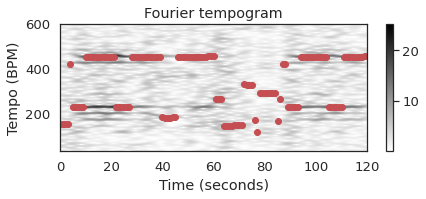

In [85]:
import libfmp.c6

nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10, norm=1)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

N = 1000
H = 10
Theta = np.arange(30, 601)
X, T_coef, F_coef_BPM = libfmp.c6.compute_tempogram_fourier(nov, Fs=Fs_nov, N=N, H=H, Theta=Theta)
tempogram = np.abs(X)
H_tempo = H

t_nov = np.arange(nov.shape[0]) / Fs_nov
coef_n = np.arange(0,1200,10)
coef_k = np.zeros(len(coef_n), dtype=int)

for i in range(len(coef_n)):
    coef_k[i] = np.argmax(tempogram[:,coef_n[i]])

fig, ax, im = libfmp.b.plot_matrix(tempogram, T_coef=T_coef, F_coef=F_coef_BPM, 
                figsize=(6.5, 3), title='Fourier tempogram', ylabel='Tempo (BPM)', interpolation='none')
ax[0].plot(T_coef[coef_n], F_coef_BPM[coef_k], 'ro')


In [86]:
#PEAK PICKING, LOCAL TEMPO

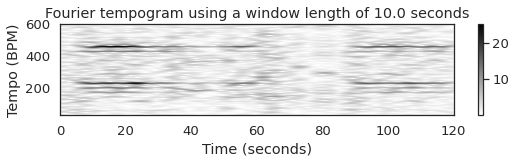

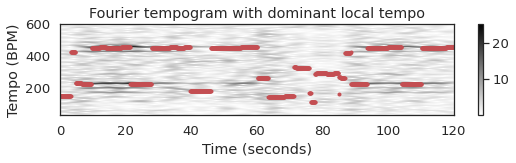

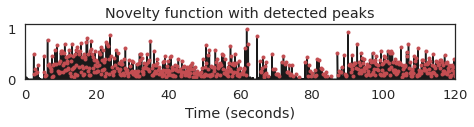

<Figure size 640x480 with 0 Axes>

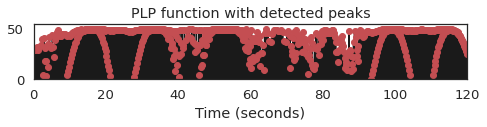

<Figure size 640x480 with 0 Axes>

In [87]:
nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10, norm=1)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

N=1000
H=10
Theta=np.arange(30,601)
L = len(nov)
X, T_coef, F_coef_BPM = libfmp.c6.compute_tempogram_fourier(nov, Fs=Fs_nov, N=N, H=H, Theta=Theta)
nov_PLP = libfmp.c6.compute_plp(X, Fs_nov, L, N, H, Theta)

tempogram = np.abs(X)
H_tempo = H
title = 'Fourier tempogram using a window length of %0.1f seconds'%(N/Fs_nov)
libfmp.b.plot_matrix(tempogram, T_coef=T_coef, F_coef=F_coef_BPM, figsize=(8,2.5),
                     title=title, ylabel='Tempo (BPM)', colorbar=True, interpolation='none');
plt.savefig(name + 'FourierTempogram.png')

fig, ax, im = libfmp.b.plot_matrix(tempogram, T_coef=T_coef, F_coef=F_coef_BPM, figsize=(8,2.5),
                     title='Fourier tempogram with dominant local tempo', ylabel='Tempo (BPM)', colorbar=True, interpolation='none')
coef_k = np.argmax(tempogram, axis=0)

ax[0].plot(T_coef, F_coef_BPM[coef_k], 'r.')

t_nov = np.arange(nov.shape[0]) / Fs_nov
peaks, properties = signal.find_peaks(nov, prominence=0.05)
peaks_sec = t_nov[peaks]
libfmp.b.plot_signal(nov, Fs_nov, color='k', figsize=(7,2),
                     title='Novelty function with detected peaks');
plt.plot(peaks_sec, nov[peaks], 'r.')
plt.show()
x_peaks = librosa.clicks(times=peaks_sec, sr=Fs, click_freq=1000, length=len(x))
ipd.display(ipd.Audio(x + x_peaks, rate=Fs))


peaks, properties = signal.find_peaks(nov_PLP, prominence=0.05)
peaks_sec = t_nov[peaks]
libfmp.b.plot_signal(nov_PLP, Fs_nov, color='k', figsize=(7,2),
                     title='PLP function with detected peaks');
plt.plot(peaks_sec, nov_PLP[peaks], 'ro')
plt.show()
x_peaks = librosa.clicks(times=peaks_sec, sr=Fs, click_freq=1000, length=len(x))
ipd.display(ipd.Audio(x + x_peaks, rate=Fs))



In [88]:
#TIMBRE ANALYSIS

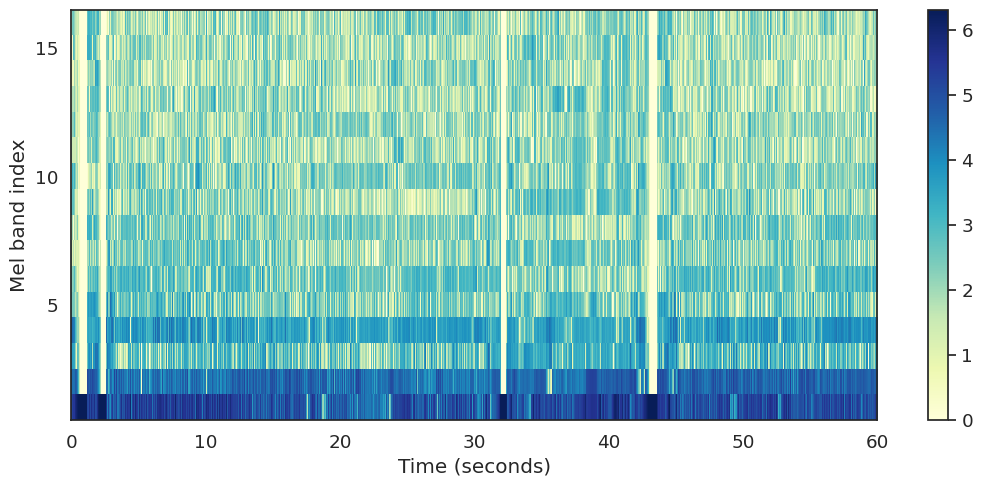

In [89]:
H_mfcc = 1024
f_mfcc = librosa.feature.mfcc(y=x, sr=Fs, n_mfcc=16, n_fft=2048, hop_length=H_mfcc)
f_mfcc_log = np.log(1 + 1*np.abs(f_mfcc))

plt.figure(figsize=(13.0, 5.33))
img = plt.imshow(f_mfcc_log, aspect='auto', origin='lower', cmap='YlGnBu', extent=[0, f_mfcc.shape[1]*512//Fs, 0, f_mfcc.shape[0]], interpolation='none')
# img = plt.imshow(10 * np.log10(np.abs(f_mfcc)**2 + 1e-10), aspect='auto', origin='lower', cmap='gray_r', extent=[0, f_mfcc.shape[1]*512//Fs, 0, f_mfcc.shape[0]], interpolation='none')
# img = plt.imshow(f_mfcc, aspect='auto', origin='lower', cmap='gray_r', extent=[0, f_mfcc.shape[1]*512//Fs, 0, f_mfcc.shape[0]], interpolation='none')
cbar = plt.colorbar()
# plt.clim([0, 50])


filt_len = 151
down_sampling = 75
f_mfcc_filtered, Fs_smooth = libfmp.c3.smooth_downsample_feature_sequence(f_mfcc_log, Fs=Fs/H, filt_len=filt_len, down_sampling=down_sampling)
# C_filtered = LibFMP.C3.normalize_feature_sequence(C_filtered, norm='2')
down_samp_mfcc = down_sampling


ax = plt.gca()
ax.set_yticks(np.arange(4.5, 19.5, 5))
ax.set_yticklabels(np.arange(5, 20, 5))
xlbl = plt.xlabel('Time (seconds)')
ylbl = plt.ylabel('Mel band index')
plt.savefig(name + 'timbreAnalysis.png')

In [90]:
#LOUDNESS COUNTER

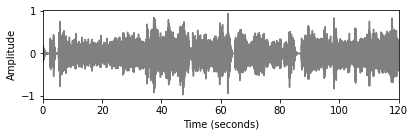

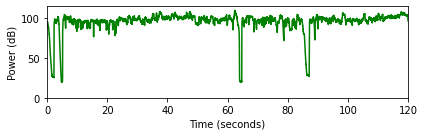

109.98 dB Maximallautstärke
95.64 dB durchschnittliche Lautstärke


In [41]:
from IPython.display import Audio
import libfmp.b


def compute_power_db(x, Fs, win_len_sec=0.1, power_ref=10**(-12)):
    """Computation of the signal power in dB

    Notebook: C1/C1S3_Dynamics.ipynb

    Args:
        x (np.ndarray): Signal (waveform) to be analyzed
        Fs (scalar): Sampling rate
        win_len_sec (float): Length (seconds) of the window (Default value = 0.1)
        power_ref (float): Reference power level (0 dB) (Default value = 10**(-12))

    Returns:
        power_db (np.ndarray): Signal power in dB
    """
    win_len = round(win_len_sec * Fs)
    win = np.ones(win_len) / win_len
    power_db = 10 * np.log10(np.convolve(x**2, win, mode='same') / power_ref)
    return power_db

win_len_sec = 0.2
power_db = compute_power_db(x, win_len_sec=win_len_sec, Fs=Fs)

maxPower=round(max(power_db),2)
avgPower=round(np.mean(power_db),2)

libfmp.b.plot_signal(x, Fs=Fs, ylabel='Amplitude')
plt.savefig(name + 'decibel.png')
plt.show()


libfmp.b.plot_signal(power_db, Fs=Fs, ylabel='Power (dB)', color='green')
plt.ylim([0, max(power_db)+5])
plt.savefig(name + 'power.png')
plt.show()

print(maxPower, "dB Maximallautstärke")
print(avgPower, "dB durchschnittliche Lautstärke")

In [92]:
#get max freq

In [106]:
def extract_peak_frequency(data, sampling_rate):
    fft_data = np.fft.fft(data)
    freqs = np.fft.fftfreq(len(data))
    
    peak_coefficient = np.argmax(np.abs(fft_data))
    peak_freq = freqs[peak_coefficient]
    
    return abs(peak_freq*sampling_rate)

In [94]:
#GetDecibel/Hertz Verteilung 

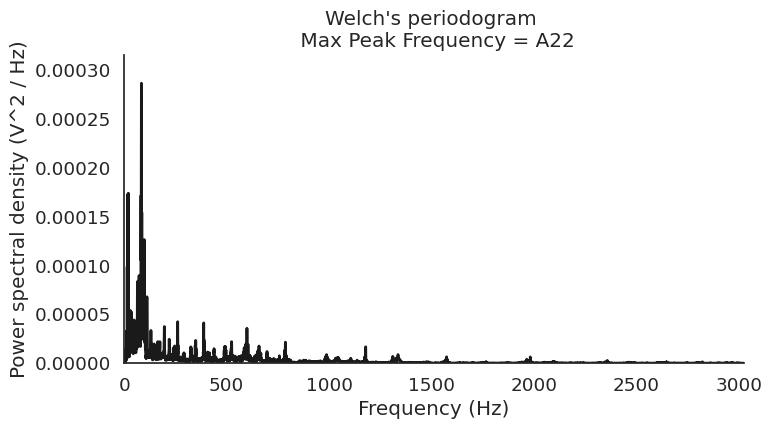

In [107]:
from scipy import signal
import seaborn as sns
sns.set(font_scale=1.2)

# Define window length (4 seconds)
win = 4 * Fs
freqs, psd = signal.welch(x, Fs, nperseg=win)

# Plot the power spectrum
sns.set(font_scale=1.2, style='white')
plt.figure(figsize=(8, 4))
plt.plot(freqs, psd, color='k', lw=2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (V^2 / Hz)')
plt.ylim([0, psd.max() * 1.1])
plt.title("Welch's periodogram \n Max Peak Frequency = " + librosa.hz_to_note(extract_peak_frequency(x, Fs)))
#HertzFrequency gekürzt um mehr Details in der Verteilung zu sehen
plt.xlim([0, freqs.max()-8000])
sns.despine()
plt.savefig(name + 'powerSpectralDensity.png')

In [108]:
#Print loudest peak and create audioFile
maxFreq=extract_peak_frequency(x, Fs)
toneName= librosa.hz_to_note(maxFreq)

#generate AudioSignal
tone = librosa.tone(maxFreq, duration=10)

# Write out audio as 24bit PCM WAV
sf.write(name + 'stereo_file.wav', tone, Fs, subtype='PCM_24')
Audio(tone,rate=Fs)